In [3]:
import requests
import json

In [1]:
url = 'http://dogdachaufa.ru/images/2018/03/01/o-nas1.jpg'

In [4]:
api_key = 'acc_395d08a0159bc7c'
api_secret = '503570816a6105e53e7fe8020a7d14ce'

response = requests.get(
    'https://api.imagga.com/v2/tags?image_url=%s' % url,
    auth=(api_key, api_secret))

print(response.json())

{'result': {'tags': [{'confidence': 29.1967906951904, 'tag': {'en': 'umbrella'}}, {'confidence': 22.9203777313232, 'tag': {'en': 'rattan'}}, {'confidence': 19.7335414886475, 'tag': {'en': 'grass'}}, {'confidence': 18.9288864135742, 'tag': {'en': 'canopy'}}, {'confidence': 18.4197826385498, 'tag': {'en': 'device'}}, {'confidence': 16.5989170074463, 'tag': {'en': 'switch'}}, {'confidence': 16.245756149292, 'tag': {'en': 'dog'}}, {'confidence': 16.1525630950928, 'tag': {'en': 'chair'}}, {'confidence': 15.4255104064941, 'tag': {'en': 'seat'}}, {'confidence': 14.7094373703003, 'tag': {'en': 'furniture'}}, {'confidence': 14.2418756484985, 'tag': {'en': 'wildlife'}}, {'confidence': 14.1612281799316, 'tag': {'en': 'shelter'}}, {'confidence': 14.1252450942993, 'tag': {'en': 'summer'}}, {'confidence': 13.7805604934692, 'tag': {'en': 'parasol'}}, {'confidence': 13.7512435913086, 'tag': {'en': 'pet'}}, {'confidence': 12.5904865264893, 'tag': {'en': 'instrument of punishment'}}, {'confidence': 12.2

In [7]:
res = response.json()
for t in res['result']['tags']:
  print(f"{t['tag']['en']} -> {t['confidence']}")


umbrella -> 29.1967906951904
rattan -> 22.9203777313232
grass -> 19.7335414886475
canopy -> 18.9288864135742
device -> 18.4197826385498
switch -> 16.5989170074463
dog -> 16.245756149292
chair -> 16.1525630950928
seat -> 15.4255104064941
furniture -> 14.7094373703003
wildlife -> 14.2418756484985
shelter -> 14.1612281799316
summer -> 14.1252450942993
parasol -> 13.7805604934692
pet -> 13.7512435913086
instrument of punishment -> 12.5904865264893
wicker -> 12.2862396240234
outdoor -> 12.2131948471069
sky -> 12.0988740921021
animal -> 12.0696821212769
outdoors -> 11.1810150146484
rest -> 10.9708461761475
mammal -> 10.4622831344604
wild -> 10.4341630935669
outside -> 10.251651763916
table -> 9.71185779571533
protective covering -> 9.55890464782715
brown -> 9.55234336853027
support -> 9.4485969543457
water -> 9.32611465454102
cute -> 9.31232929229736
tree -> 9.28731727600098
animals -> 9.2454252243042
travel -> 9.13918590545654
park bench -> 9.05969047546387
resort -> 8.97235679626465
work -

In [8]:
response = requests.get(
    'https://api.imagga.com/v2/categorizers',
    auth=(api_key, api_secret))

print(response.json())

{'result': {'categorizers': [{'id': 'general_v3', 'labels': [''], 'title': 'general_v3'}, {'id': 'nsfw_beta', 'labels': ['nsfw', 'safe', 'underwear'], 'title': 'NSFW Categorizer (beta v2)'}, {'id': 'personal_photos', 'labels': ['interior objects', 'nature landscape', 'beaches seaside', 'events parties', 'food drinks', 'paintings art', 'pets animals', 'text visuals', 'sunrises sunsets', 'cars vehicles', 'macro flowers', 'streetview architecture', 'people portraits'], 'title': 'Personal Photos Categorizer'}, {'id': 'realestate_dwellings', 'labels': ['Airey house', 'Assam-type house', 'Brownstone', 'Bungalow', 'Cape Cod', 'Colonial', 'Conch house', 'Converted Barn', 'Cottage', 'Craftsman', 'Dacha', 'Farmhouse', 'Georgian', 'Hanok', 'Houseboat', 'Igloo', 'Izba', 'Log cabin', 'Mansion', 'Manufactured House', 'Minka', 'Park home Mobile home', 'Penthouse', 'Ranch', 'Terraced house', 'Tower block', ' Apartment tower', 'Town House', 'Tree house', 'Yurt'], 'title': 'Real Estate - Dwellings Categ

In [13]:
!wget {url}

--2023-02-04 07:55:59--  http://dogdachaufa.ru/images/2018/03/01/o-nas1.jpg
Resolving dogdachaufa.ru (dogdachaufa.ru)... 31.31.196.94
Connecting to dogdachaufa.ru (dogdachaufa.ru)|31.31.196.94|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 754595 (737K) [image/jpeg]
Saving to: ‘o-nas1.jpg’

o-nas1.jpg          100%[===================>] 736.91K  1.11MB/s    in 0.6s    

2023-02-04 07:56:00 (1.11 MB/s) - ‘o-nas1.jpg’ saved [754595/754595]



In [20]:
def categorize(fname,categorizer='personal_photos'):
  response = requests.post(
    f'https://api.imagga.com/v2/categories/{categorizer}',
    auth=(api_key, api_secret),
    files={'image': open(fname, 'rb')})
  return response.json()['result']['categories']
  
res = categorize("o-nas1.jpg")
res

In [22]:
fname = "images/2022-07-31 12-42-57.jpg"
categorize(fname,categorizer='general_v3')

In [29]:
import os 

def face_detect(fname):
  param = { 'return_face_id' : 1, 'return_attributes' : 1, 'return_landmarks' : 1 }
  param = { 'return_face_id' : 1 }
  return requests.post(
    'https://api.imagga.com/v2/faces/detections',
    auth=(api_key, api_secret),
    files=
      {
          'json' : (None, json.dumps(param), 'application/json'),
          'image': (os.path.basename(fname), open(fname, 'rb'), 'application/octet-stream')
      }
    ).json()['result']['faces']
  
res = face_detect(fname)
res

[{'attributes': [],
  'confidence': 99.9999618530273,
  'coordinates': {'height': 227,
   'width': 227,
   'xmax': 989,
   'xmin': 762,
   'ymax': 665,
   'ymin': 438},
  'face_id': '',
  'landmarks': []},
 {'attributes': [],
  'confidence': 99.9835052490234,
  'coordinates': {'height': 278,
   'width': 278,
   'xmax': 587,
   'xmin': 309,
   'ymax': 530,
   'ymin': 252},
  'face_id': '',
  'landmarks': []}]

In [42]:
import base64

def face_detect(fname):
  param = { 
      'image_base64' : base64.b64encode(open(fname,'rb').read()).decode(),
      'return_face_id' : 1,
      'return_attributes' : 1,
      'return_landmarks' : 1
  }
  return requests.post(
    'https://api.imagga.com/v2/faces/detections',
    auth=(api_key, api_secret),
    data=param
    ).json()['result']['faces']

res = face_detect(fname)
res

[{'attributes': [],
  'confidence': 99.9999618530273,
  'coordinates': {'height': 227,
   'width': 227,
   'xmax': 989,
   'xmin': 762,
   'ymax': 665,
   'ymin': 438},
  'face_id': 'cbc447ca126cd758599691a4e30700f31ea816b57a89c3cb59da2b7635e79a64',
  'landmarks': []},
 {'attributes': [],
  'confidence': 99.9835052490234,
  'coordinates': {'height': 278,
   'width': 278,
   'xmax': 587,
   'xmin': 309,
   'ymax': 530,
   'ymin': 252},
  'face_id': '6dd53e96affe34473b57f9a9a92e37ba9d345e383e567692a6b580ad1e282721',
  'landmarks': []}]

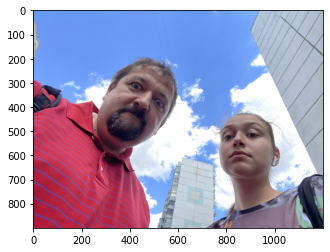

In [41]:
import cv2
import matplotlib.pyplot as plt

def imread(fn):
  return cv2.cvtColor(cv2.imread(fn),cv2.COLOR_BGR2RGB)

plt.imshow(imread(fname))

In [44]:
faces = {}
for f in os.listdir('images'):
  img = imread(f'images/{f}')
  fcs = face_detect(f'images/{f}')
  print(f'{f} -> {len(fcs)}')
  for face in fcs:
    id = face['face_id']
    c = face['coordinates']
    faces[id] = img[c['ymin']:c['ymax'],c['xmin']:c['xmax'],:]

2022-10-29 14-32-16.jpg -> 1
2022-10-29 16-43-45.jpg -> 2
2022-10-23 16-32-28.jpg -> 1
2022-11-05 00-03-25_1667674252554.JPG -> 3
2022-07-31 12-42-57.jpg -> 2
2022-10-30 15-37-04.jpg -> 2
2022-08-22 18-30-03.jpg -> 1
2022-07-31 17-12-51.jpg -> 4


In [46]:
faces.keys()

dict_keys(['14984b4f842ef21d8d6d197441324d7e5a98b182c89ee4f7d72bd482a4c382a7', '75b650fa18918f54dc006d1398e9ccc8fff43670677684669c39538b5a191a37', 'd0d948d91f63409c62fa1e9529cf5bbbfbfb95670a40c2b9237693c7aeb8f255', '2d2003a23e07dd564cbb08c1dd6038ec8c45a1f3b02f1e6dc73e30e18e906233', '0ca9eb63444e6bdd841497ed03f3346b14bac3953dca4e42223f375d7cde86de', '0a5445ed3cc42a12996d9f1e3f10d5c8b06eeb0f653b3276068058f0caf6d391', '56e20a718d80ffad9b61eac977b221bdcb47c4c343b7c3ae323b1d1a30297152', '59764f451a42008d9b695008e1644fcaa7cf2a18c6f0ac05523606376d6f288d', 'c8a8a2d4b2a35c9d0a8619a6436b904444f55a4a58062f74efe2ed458fbb557e', '2caa57308a211e7678bda7837e178759141442d0f370ef430d2b67b0abfe6d5c', 'ab2047dd40879792ecef58dfe86bf648eca44d403c75dc1b3f3411a3ffd750bd', 'ae9312a520d0cd5cbadf6ea41939fb0661469236aec6b25c13ab7afd6dd97795', 'bce3504bebdac97160f9f8e4fed3382d1e26291842437c782ab3db2a92d60e37', '2b30b2edc5c60753540cac224767b8de84ef50d62c9124d9fd9acc5d77fea871', '475a3f293d54b9e7361d116bcd9c2f8f86a4

In [47]:
def display_images(l):
    n=len(l)
    fig,ax = plt.subplots(1,n)
    for i,im in enumerate(l):
        ax[i].imshow(im)
        ax[i].axis('off')
    fig.set_size_inches(fig.get_size_inches()*n)
    plt.tight_layout()
    plt.show()
    

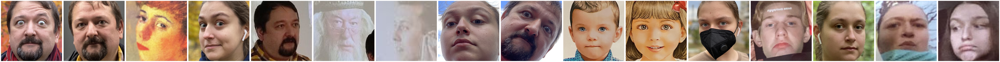

In [48]:
display_images(faces.values())

In [55]:
def group(face_id_list):
    d = { "faces": face_id_list }
    res = requests.post("https://api.imagga.com/v2/faces/groupings", 
                        json = d,auth=(api_key, api_secret))
    return res.json()

ticket = group(list(faces.keys()))

In [56]:
ticket

{'result': {'ticket_id': '5e39e143bc0fa471e05d7e5047233d2a91024049a549026770b70c42455dc8cc31c9ad17e57313f2e399de96fe9592897e00'},
 'status': {'text': '', 'type': 'success'}}

In [57]:
def check(ticket_id):
    return requests.get(
        f"https://api.imagga.com/v2/tickets/{ticket_id}",auth=(api_key, api_secret)).json()

res = check(ticket['result']['ticket_id'])
res

{'result': {'is_final': True,
  'ticket_result': {'groups': [['14984b4f842ef21d8d6d197441324d7e5a98b182c89ee4f7d72bd482a4c382a7',
     '75b650fa18918f54dc006d1398e9ccc8fff43670677684669c39538b5a191a37',
     '0ca9eb63444e6bdd841497ed03f3346b14bac3953dca4e42223f375d7cde86de',
     'c8a8a2d4b2a35c9d0a8619a6436b904444f55a4a58062f74efe2ed458fbb557e'],
    ['d0d948d91f63409c62fa1e9529cf5bbbfbfb95670a40c2b9237693c7aeb8f255'],
    ['2d2003a23e07dd564cbb08c1dd6038ec8c45a1f3b02f1e6dc73e30e18e906233',
     '59764f451a42008d9b695008e1644fcaa7cf2a18c6f0ac05523606376d6f288d',
     'ae9312a520d0cd5cbadf6ea41939fb0661469236aec6b25c13ab7afd6dd97795',
     '2b30b2edc5c60753540cac224767b8de84ef50d62c9124d9fd9acc5d77fea871'],
    ['0a5445ed3cc42a12996d9f1e3f10d5c8b06eeb0f653b3276068058f0caf6d391'],
    ['56e20a718d80ffad9b61eac977b221bdcb47c4c343b7c3ae323b1d1a30297152'],
    ['2caa57308a211e7678bda7837e178759141442d0f370ef430d2b67b0abfe6d5c'],
    ['ab2047dd40879792ecef58dfe86bf648eca44d403c75dc1b3f3411a

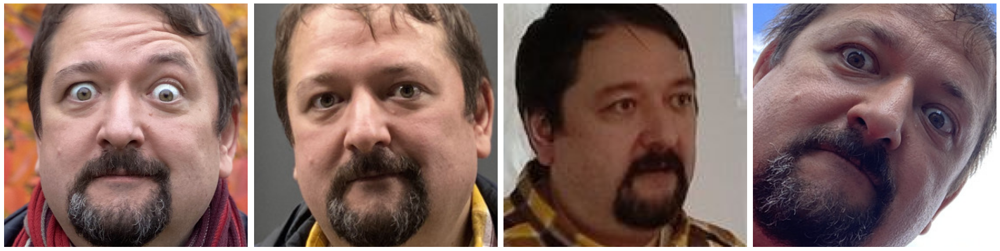

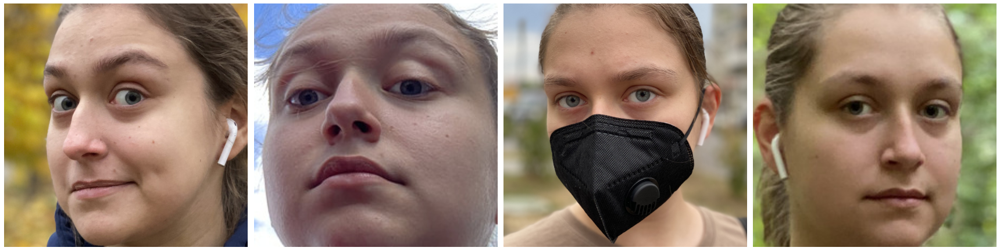

In [60]:
for g in res['result']['ticket_result']['groups']:
  if len(g)>1:
    display_images([faces[x] for x in g])

## DeepFace

In [61]:
!pip install deepface

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.9/48.9 KB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 33.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.3/88.3 KB 9.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for fire: filename=fire-0.5.0-py2.py3-none-any.whl size=116949 sha256=1ec4e913ea140c7a016f5aa4f92e7732ac81369cd57e65913835910270af366d
  Stored in directory: /root/.cache/pip/wheels/5b/eb/43/7295e71293b218ddfd627f935229bf54af9018add7fbb5aac6
Successfully built fire


In [62]:
from deepface import DeepFace

Directory  /root /.deepface created
Directory  /root /.deepface/weights created


In [66]:
DeepFace.analyze('images/2022-07-31 17-12-51.jpg')

Action: race: 100%|██████████| 4/4 [00:01<00:00,  2.00it/s]


[{'emotion': {'angry': 0.06474879919551313,
   'disgust': 1.0823910344404108e-09,
   'fear': 0.1606286969035864,
   'happy': 7.600095123052597,
   'sad': 1.6598593443632126,
   'surprise': 4.052455722103332e-05,
   'neutral': 90.51463007926941},
  'dominant_emotion': 'neutral',
  'region': {'x': 117, 'y': 45, 'w': 42, 'h': 42},
  'age': 24,
  'gender': {'Woman': 7.31968879699707, 'Man': 92.68031120300293},
  'dominant_gender': 'Man',
  'race': {'asian': 4.129575937986374,
   'indian': 3.9499595761299133,
   'black': 18.864011764526367,
   'white': 37.67203986644745,
   'middle eastern': 17.571628093719482,
   'latino hispanic': 17.812788486480713},
  'dominant_race': 'white'},
 {'emotion': {'angry': 0.0010015806480813093,
   'disgust': 1.958905914882879e-07,
   'fear': 98.6459495251239,
   'happy': 1.2265416262696234,
   'sad': 0.11391491668195526,
   'surprise': 0.00681252123019405,
   'neutral': 0.005775892025614922},
  'dominant_emotion': 'fear',
  'region': {'x': 842, 'y': 240, 'w'

In [71]:
def analyze(f):
  try:
    return DeepFace.analyze(f)
  except:
    return []

fcs = []
for f in os.listdir('images'):
  img = imread(f'images/{f}')
  res = analyze(f'images/{f}')
  print(f'{f} -> {len(res)}')
  for fc in res:
    c = fc['region']
    fcs.append(
        { 
          'Age' : fc['age'],
          'Happy' : fc['emotion']['happy'],
          'Sad' : fc['emotion']['sad'],
          'Emotion' : fc['dominant_emotion'],
          'Gender' : fc['dominant_gender'],
          'img' : img[c['y']:c['y']+c['h'],c['x']:c['x']+c['w'],:]
        })


Action: race: 100%|██████████| 4/4 [00:02<00:00,  1.97it/s]


2022-10-29 14-32-16.jpg -> 1


Action: race: 100%|██████████| 4/4 [00:02<00:00,  1.93it/s]


2022-10-29 16-43-45.jpg -> 1


Action: race: 100%|██████████| 4/4 [00:02<00:00,  1.99it/s]


2022-10-23 16-32-28.jpg -> 1


Action: race: 100%|██████████| 4/4 [00:02<00:00,  2.00it/s]


2022-11-05 00-03-25_1667674252554.JPG -> 1
2022-07-31 12-42-57.jpg -> 0


Action: race: 100%|██████████| 4/4 [00:02<00:00,  1.99it/s]


2022-10-30 15-37-04.jpg -> 2
2022-08-22 18-30-03.jpg -> 0


Action: race: 100%|██████████| 4/4 [00:02<00:00,  1.98it/s]

2022-07-31 17-12-51.jpg -> 11


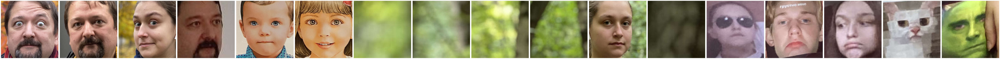

In [72]:
display_images([x['img'] for x in fcs])

In [75]:
import pandas as pd
df = pd.DataFrame(fcs)
df.drop(columns=['img'],inplace=True)
df

,Age,Happy,Sad,Emotion,Gender
0,42,0.001373,0.904439,fear,Man
1,44,0.534671,38.943597,angry,Man
2,32,0.006835,98.789704,sad,Woman
3,39,0.002351,55.178099,sad,Man
4,17,0.048747,1.311277,neutral,Man
5,31,88.342871,0.135837,happy,Woman
6,24,7.600095,1.659859,neutral,Man
7,24,1.226542,0.113915,fear,Man
8,25,0.001513,0.021265,angry,Man
9,34,0.667222,2.277887,neutral,Man


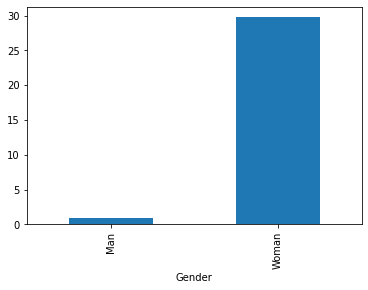

In [76]:
df.groupby('Gender').mean()['Happy'].plot.bar()

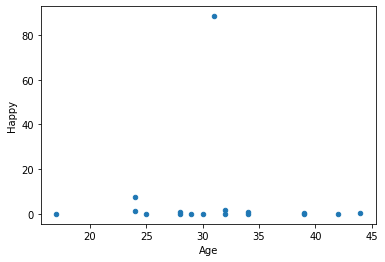

In [77]:
df.plot.scatter(x='Age',y='Happy')

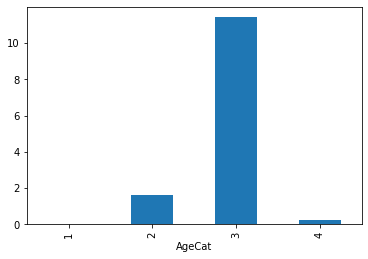

In [78]:
df['AgeCat'] = df['Age'] // 10
df.groupby('AgeCat').mean()['Happy'].plot.bar()

## OpenCV

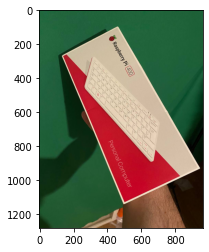

In [80]:
img = imread('box.jpg')
plt.imshow(img)

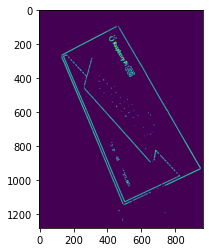

In [121]:
im = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
im = cv2.blur(im,(3,3))
#_,im = cv2.threshold(im,200,255,cv2.THRESH_BINARY)
im = cv2.adaptiveThreshold(im, 255, cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY_INV, 9, 20)
im = cv2.medianBlur(im, 5)
_,im = cv2.threshold(im, 0, 255, cv2.THRESH_OTSU)
im = cv2.GaussianBlur(im, (5,5), 0)
_,im = cv2.threshold(im, 0, 255, cv2.THRESH_OTSU)

plt.imshow(im)

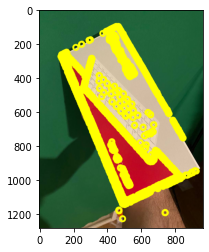

In [126]:
orb = cv2.ORB_create(5000)
f,d = orb.detectAndCompute(im,None)

def plot_dots(img,dots):
  img = img.copy()
  for x in dots:
    x = int(x[0]),int(x[1])
    cv2.circle(img,x,15,(255,255,0),10)
  plt.imshow(img)

dots = [x.pt for x in f]

plot_dots(img,dots)

In [125]:
import numpy as np 

idxs = [
    np.argmin([x[0] for x in dots]),
    np.argmin([x[1] for x in dots]),
    np.argmax([x[0] for x in dots]),
    np.argmax([x[1] for x in dots])]
idxs


[3758, 0, 752, 1726]

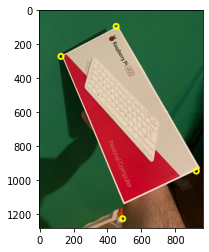

In [127]:
corners = [dots[i] for i in idxs]
plot_dots(img,corners)

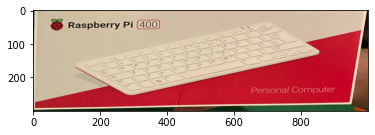

In [128]:
w,h = 1000,300

dst_pts = np.array([(0,h),(0,0),(w,0),(w,h)])
ho,m = cv2.findHomography(np.array(corners),dst_pts)
res = cv2.warpPerspective(img,ho,(w,h))
plt.imshow(res)


## Когнитивный портрет

In [133]:
from deepface.detectors import FaceDetector
detector = FaceDetector.build_model("mtcnn")

img = imread("images/IMG_20220720_213034 Андрей.jpg")
detector.detect_faces(img)

1/1 [==============================] - 0s 35ms/step


[{'box': [96, 82, 90, 109],
  'confidence': 0.9999931454658508,
  'keypoints': {'left_eye': (124, 130),
   'right_eye': (165, 120),
   'nose': (151, 148),
   'mouth_left': (134, 166),
   'mouth_right': (172, 158)}}]

In [136]:
images = []
boxes = []
keypoints = []
for f in os.listdir('images'):
  print(f"{f} -> {len(res)}")
  try:
    img = imread(f'images/{f}')
    res = detector.detect_faces(img)
    if len(res)>0:
      for x in res:
        images.append(img)
        boxes.append(x['box'])
        keypoints.append(x['keypoints'])
  except:
    print('ERROR')

2023-02-04_13-04-12 Андрей.png -> 1
1/1 [==============================] - 0s 37ms/step
2022-10-29 14-32-16.jpg -> 1
2/2 [==============================] - 0s 10ms/step
9Rfy1USXWn4qkHReH65qinLFHXEeb14s Андрей.png -> 1
1/1 [==============================] - 0s 38ms/step
photo_2023-02-04_13-12-17 Иван.jpg -> 1
1/1 [==============================] - 0s 27ms/step
2022-10-29 16-43-45.jpg -> 1
1/1 [==============================] - 0s 40ms/step
2946 Иван.jpg -> 2
1/1 [==============================] - 0s 22ms/step
2022-10-23 16-32-28.jpg -> 1
1/1 [==============================] - 0s 34ms/step
2022-10-29 14-32-16 Dmitri Soshnikov.jpg -> 1
2/2 [==============================] - 0s 10ms/step
40-of-the-most-amazing-humans-met-on-the-streets-by-the-humans-of-movement-worldwide34__700 Иван.jpg -> 1
1/1 [==============================] - 0s 58ms/step
2022-11-05 00-03-25_1667674252554.JPG -> 1
1/1 [==============================] - 0s 32ms/step
20220613_120009 Иван.jpg -> 1
1/1 [===================

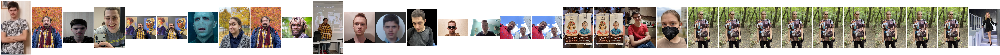

In [138]:
display_images(images)

[85, 106, 119, 123]


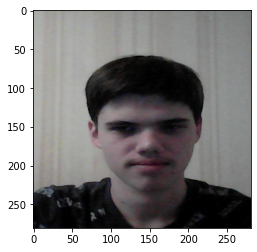

In [142]:
plt.imshow(images[2])
print(boxes[2])

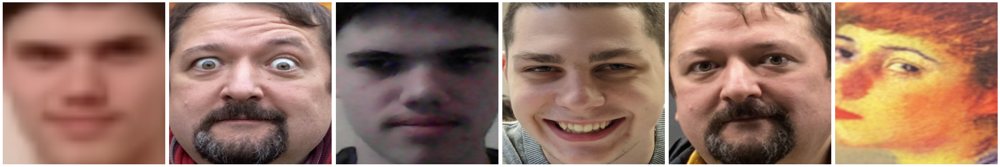

In [146]:
def transform_face(img, coords):
  x,y,w,h = coords
  size = 300
  dst_pts = np.array([(0,0),(0,size),(size,0),(size,size)])
  src_pts = np.array([(x,y),(x,y+h),(x+w,y),(x+w,y+h)])
  ho,m = cv2.findHomography(src_pts,dst_pts)
  res = cv2.warpPerspective(img,ho,(size,size))
  return res

res = [transform_face(x,c) for x,c in zip(images,boxes)]
display_images(res[:6])

In [157]:
res = np.array(res).astype(float)/255.0
res.shape

(32, 300, 300, 3)

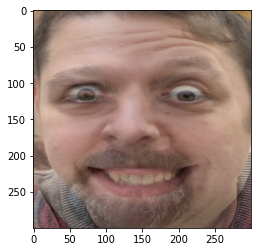

In [158]:
plt.imshow((res[1]+res[3])/2)

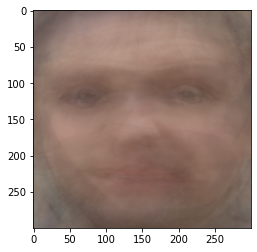

In [163]:
plt.imshow(np.mean(res,axis=0))

In [164]:
keypoints[0]

{'left_eye': (35, 33),
 'right_eye': (48, 33),
 'nose': (41, 41),
 'mouth_left': (36, 46),
 'mouth_right': (47, 46)}

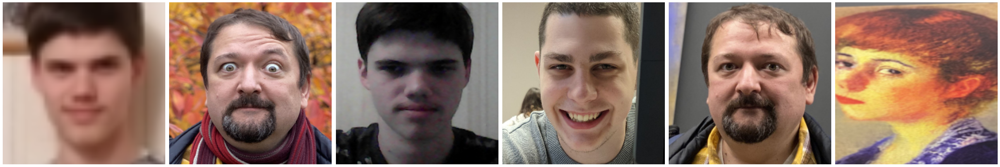

In [191]:
def transform_face(img, pts):
  size = 300
  #src_pts = np.float32([pts['left_eye'],pts['right_eye'],pts['nose']])
  #dst_pts = np.float32([[140,100],[160,100],[150,150]])
  mm = (pts['mouth_left'][0]+pts['mouth_right'][0])/2.0,(pts['mouth_left'][1]+pts['mouth_right'][1])/2.0
  mm = np.float32([pts['mouth_left'],pts['mouth_right']]).mean(axis=0)
  src_pts = np.float32([pts['left_eye'],pts['right_eye'],mm])
  dst_pts = np.float32([[110,120],[190,120],[150,200]])
  tr = cv2.getAffineTransform(src_pts,dst_pts)
  res = cv2.warpAffine(img,tr,(size,size))
  return res

res = [transform_face(x,c) for x,c in zip(images,keypoints)]
display_images(res[:6])

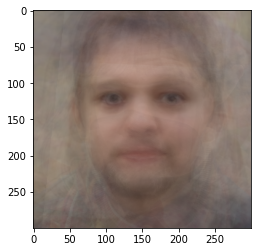

In [192]:
res = np.float32(res)/255.0
plt.imshow(np.mean(res,axis=0))

## Video and Optical Flow

In [193]:
!wget http://www.soshnikov.com/permanent/data/torchvideo.mp4

--2023-02-04 11:11:39--  http://www.soshnikov.com/permanent/data/torchvideo.mp4
Resolving www.soshnikov.com (www.soshnikov.com)... 79.137.227.122
Connecting to www.soshnikov.com (www.soshnikov.com)|79.137.227.122|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 21843679 (21M) [text/plain]
Saving to: ‘torchvideo.mp4’

torchvideo.mp4      100%[===================>]  20.83M   261KB/s    in 84s     

2023-02-04 11:13:04 (255 KB/s) - ‘torchvideo.mp4’ saved [21843679/21843679]



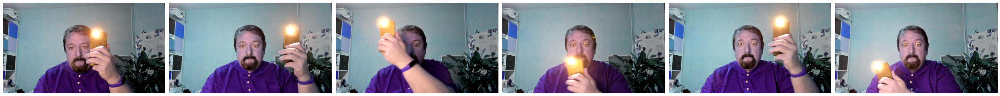

In [195]:
vid = cv2.VideoCapture('torchvideo.mp4')

frames = []
while vid.isOpened():
  ret,frame = vid.read()
  if not ret:
    break
  frames.append(frame)
vid.release()

display_images(frames[::50])

In [196]:
bwframes = [cv2.cvtColor(x,cv2.COLOR_BGR2GRAY) for x in frames ]
flows = [cv2.calcOpticalFlowFarneback(f1, f2, None, 0.5, 3, 15, 3, 5, 1.2, 0) 
         for f1,f2 in zip(bwframes[:-1],bwframes[1:])]

In [197]:
flows[0].shape

(1080, 1920, 2)

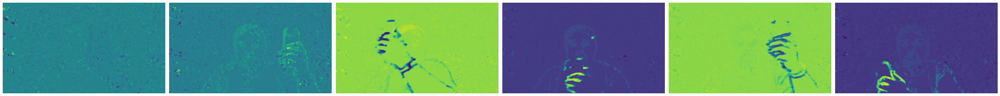

In [202]:
display_images([f[:,:,0] for f in flows[::50]])

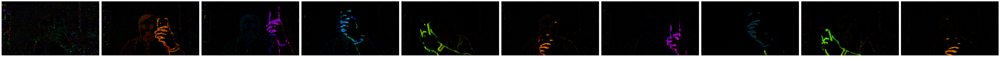

In [205]:
def cvtflow(f):
  mag, ang = cv2.cartToPolar(f[:,:,0],f[:,:,1])
  img = np.zeros((f.shape[0],f.shape[1],3),dtype = np.uint8)
  img[:,:,0] = ang/np.pi*100
  img[:,:,1] = 255
  img[:,:,2] = cv2.normalize(mag,None,0,255,cv2.NORM_MINMAX)
  return cv2.cvtColor(img,cv2.COLOR_HSV2RGB)

display_images([cvtflow(f) for f in flows[::30]])